#Data downloading

In [1]:
!wget https://isic-challenge-data.s3.amazonaws.com/2020/ISIC_2020_Training_JPEG.zip
!wget https://isic-challenge-data.s3.amazonaws.com/2020/ISIC_2020_Training_GroundTruth.csv

--2023-12-01 12:21:12--  https://isic-challenge-data.s3.amazonaws.com/2020/ISIC_2020_Training_JPEG.zip
Resolving isic-challenge-data.s3.amazonaws.com (isic-challenge-data.s3.amazonaws.com)... 54.231.194.241, 3.5.29.47, 52.216.40.97, ...
Connecting to isic-challenge-data.s3.amazonaws.com (isic-challenge-data.s3.amazonaws.com)|54.231.194.241|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 24707698022 (23G) [application/zip]
Saving to: ‘ISIC_2020_Training_JPEG.zip’

ISIC_2020_Training_ 100%[===================>]  23.01G  23.6MB/s    in 19m 27s 

2023-12-01 12:40:40 (20.2 MB/s) - ‘ISIC_2020_Training_JPEG.zip’ saved [24707698022/24707698022]

--2023-12-01 12:40:40--  https://isic-challenge-data.s3.amazonaws.com/2020/ISIC_2020_Training_GroundTruth.csv
Resolving isic-challenge-data.s3.amazonaws.com (isic-challenge-data.s3.amazonaws.com)... 52.217.137.97, 52.216.53.49, 52.217.32.92, ...
Connecting to isic-challenge-data.s3.amazonaws.com (isic-challenge-data.s3.amazona

In [2]:
!mv ISIC_2020_Training_GroundTruth.csv labels.csv

In [3]:
!unzip ISIC_2020_Training_JPEG.zip

Archive:  ISIC_2020_Training_JPEG.zip
   creating: train/
  inflating: train/ISIC_1260198.jpg  
  inflating: train/ISIC_9893956.jpg  
  inflating: train/ISIC_4619903.jpg  
  inflating: train/ISIC_9706782.jpg  
  inflating: train/ISIC_2021321.jpg  
  inflating: train/ISIC_2631789.jpg  
  inflating: train/ISIC_1807319.jpg  
  inflating: train/ISIC_8369671.jpg  
  inflating: train/ISIC_6762061.jpg  
  inflating: train/ISIC_1152648.jpg  
  inflating: train/ISIC_7195659.jpg  
  inflating: train/ISIC_5913530.jpg  
  inflating: train/ISIC_5497851.jpg  
  inflating: train/ISIC_2786160.jpg  
  inflating: train/ISIC_7712138.jpg  
  inflating: train/ISIC_0747101.jpg  
  inflating: train/ISIC_6617618.jpg  
  inflating: train/ISIC_4732788.jpg  
  inflating: train/ISIC_8622204.jpg  
  inflating: train/ISIC_9474470.jpg  
  inflating: train/ISIC_6081468.jpg  
  inflating: train/ISIC_9486313.jpg  
  inflating: train/ISIC_9125543.jpg  
  inflating: train/ISIC_9823318.jpg  
  inflating: train/ISIC_944194

In [4]:
!rm ISIC_2020_Training_JPEG.zip

In [8]:
!pip install seaborn
!pip install opencv-python

Defaulting to user installation because normal site-packages is not writeable
DEPRECATION: distro-info 1.1build1 has a non-standard version number. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of distro-info or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063
DEPRECATION: python-debian 0.1.43ubuntu1 has a non-standard version number. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of python-debian or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063
Defaulting to user installation because normal site-packages is not writeable
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 MB 38.2 MB/s eta 0:00:0000:0100:01
DEPRECATION: distro-info 1.1build1 has a non-stan

# Labels

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import random
import cv2
from PIL import Image

## Metadata research

In [8]:
sdir = '../train/'
flist = os.listdir(sdir)

In [9]:
flist

['ISIC_2484586.jpg',
 'ISIC_6644441.jpg',
 'ISIC_2508759.jpg',
 'ISIC_3342474.jpg',
 'ISIC_5384663.jpg',
 'ISIC_5307070.jpg',
 'ISIC_6207286.jpg',
 'ISIC_9862801.jpg',
 'ISIC_0811352.jpg',
 'ISIC_5013602.jpg',
 'ISIC_4114269.jpg',
 'ISIC_6319958.jpg',
 'ISIC_2306653.jpg',
 'ISIC_3858798.jpg',
 'ISIC_7487840.jpg',
 'ISIC_2019313.jpg',
 'ISIC_7750443.jpg',
 'ISIC_0283463.jpg',
 'ISIC_0797473.jpg',
 'ISIC_4071342.jpg',
 'ISIC_2554708.jpg',
 'ISIC_8139762.jpg',
 'ISIC_2601107.jpg',
 'ISIC_1779443.jpg',
 'ISIC_6023882.jpg',
 'ISIC_1483604.jpg',
 'ISIC_9749497.jpg',
 'ISIC_3018184.jpg',
 'ISIC_6577388.jpg',
 'ISIC_4667287.jpg',
 'ISIC_1151929.jpg',
 'ISIC_1010525.jpg',
 'ISIC_9155028.jpg',
 'ISIC_7791770.jpg',
 'ISIC_5671321.jpg',
 'ISIC_9037453.jpg',
 'ISIC_6323710.jpg',
 'ISIC_5665277.jpg',
 'ISIC_6108865.jpg',
 'ISIC_8224029.jpg',
 'ISIC_5251834.jpg',
 'ISIC_8976889.jpg',
 'ISIC_2195832.jpg',
 'ISIC_5775708.jpg',
 'ISIC_0170059.jpg',
 'ISIC_7368597.jpg',
 'ISIC_4688253.jpg',
 'ISIC_706687

In [10]:
labels = pd.read_csv('../labels.csv')

In [11]:
labels

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
0,ISIC_2637011,IP_7279968,male,45.0,head/neck,unknown,benign,0
1,ISIC_0015719,IP_3075186,female,45.0,upper extremity,unknown,benign,0
2,ISIC_0052212,IP_2842074,female,50.0,lower extremity,nevus,benign,0
3,ISIC_0068279,IP_6890425,female,45.0,head/neck,unknown,benign,0
4,ISIC_0074268,IP_8723313,female,55.0,upper extremity,unknown,benign,0
...,...,...,...,...,...,...,...,...
33121,ISIC_9999134,IP_6526534,male,50.0,torso,unknown,benign,0
33122,ISIC_9999320,IP_3650745,male,65.0,torso,unknown,benign,0
33123,ISIC_9999515,IP_2026598,male,20.0,lower extremity,unknown,benign,0
33124,ISIC_9999666,IP_7702038,male,50.0,lower extremity,unknown,benign,0


In [12]:
labels.target.value_counts()

target
0    32542
1      584
Name: count, dtype: int64

In [6]:
labels.benign_malignant.value_counts()

benign_malignant
benign       32542
malignant      584
Name: count, dtype: int64

In [7]:
labels.diagnosis.value_counts()

diagnosis
unknown                               27124
nevus                                  5193
melanoma                                584
seborrheic keratosis                    135
lentigo NOS                              44
lichenoid keratosis                      37
solar lentigo                             7
cafe-au-lait macule                       1
atypical melanocytic proliferation        1
Name: count, dtype: int64

In [75]:
labels[labels.diagnosis == 'melanoma'].target.sum()

584

In [9]:
len(labels[labels.diagnosis == 'melanoma'])

584

note: все классы, кроме melanoma являются доброкачественными опухолями

In [10]:
labels.age_approx.value_counts()

age_approx
45.0    4466
50.0    4270
55.0    3824
40.0    3576
60.0    3240
35.0    2850
65.0    2527
30.0    2358
70.0    1968
25.0    1544
75.0     981
20.0     655
80.0     419
85.0     149
15.0     132
90.0      80
10.0      17
0.0        2
Name: count, dtype: int64

In [11]:
for column in labels.columns:
    print(f'{column}: {labels[column].isnull().sum()}')

image_name: 0
patient_id: 0
sex: 65
age_approx: 68
anatom_site_general_challenge: 527
diagnosis: 0
benign_malignant: 0
target: 0


In [12]:
labels.age_approx.describe()

count    33058.000000
mean        48.870016
std         14.380360
min          0.000000
25%         40.000000
50%         50.000000
75%         60.000000
max         90.000000
Name: age_approx, dtype: float64

In [21]:
labels.anatom_site_general_challenge.value_counts()

anatom_site_general_challenge
torso              16845
lower extremity     8417
upper extremity     4983
head/neck           1855
palms/soles          375
oral/genital         124
Name: count, dtype: int64

In [59]:
a = 'fsdfdfsd21'
a[:-2]

'fsdfdfsd'

## Research images resolution

In [34]:
width = [0 for _ in range(len(flist))]
height = [0 for _ in range(len(flist))]
for i, img in enumerate(flist):
    img = Image.open(sdir+img)
    width[i] = img.size[0]
    height[i] = img.size[1]

ISIC_2484586.jpg
ISIC_6644441.jpg
ISIC_2508759.jpg
ISIC_3342474.jpg
ISIC_5384663.jpg
ISIC_5307070.jpg
ISIC_6207286.jpg
ISIC_9862801.jpg
ISIC_0811352.jpg
ISIC_5013602.jpg
ISIC_4114269.jpg
ISIC_6319958.jpg
ISIC_2306653.jpg
ISIC_3858798.jpg
ISIC_7487840.jpg
ISIC_2019313.jpg
ISIC_7750443.jpg
ISIC_0283463.jpg
ISIC_0797473.jpg
ISIC_4071342.jpg
ISIC_2554708.jpg
ISIC_8139762.jpg
ISIC_2601107.jpg
ISIC_1779443.jpg
ISIC_6023882.jpg
ISIC_1483604.jpg
ISIC_9749497.jpg
ISIC_3018184.jpg
ISIC_6577388.jpg
ISIC_4667287.jpg
ISIC_1151929.jpg
ISIC_1010525.jpg
ISIC_9155028.jpg
ISIC_7791770.jpg
ISIC_5671321.jpg
ISIC_9037453.jpg
ISIC_6323710.jpg
ISIC_5665277.jpg
ISIC_6108865.jpg
ISIC_8224029.jpg
ISIC_5251834.jpg
ISIC_8976889.jpg
ISIC_2195832.jpg
ISIC_5775708.jpg
ISIC_0170059.jpg
ISIC_7368597.jpg
ISIC_4688253.jpg
ISIC_7066874.jpg
ISIC_8252423.jpg
ISIC_5182179.jpg
ISIC_0924215.jpg
ISIC_6757832.jpg
ISIC_5869699.jpg
ISIC_8340303.jpg
ISIC_2330388.jpg
ISIC_3957034.jpg
ISIC_8008932.jpg
ISIC_9982091.jpg
ISIC_9876004.j

In [84]:
mel = 0
nev = 0
for i, img_path in enumerate(flist):
    img = Image.open(sdir + img_path)
    print(img_path)
    img_path = img_path[:-4]
    if img.size[0] > 2000:
        if labels[(labels['image_name'] == img_path)].target.values == 1:
            mel += 1
        else:
            nev += 1

print('Melanoma: ', mel)
print('Nevus: ', nev)

ISIC_2484586.jpg
ISIC_6644441.jpg
ISIC_2508759.jpg
ISIC_3342474.jpg
ISIC_5384663.jpg
ISIC_5307070.jpg
ISIC_6207286.jpg
ISIC_9862801.jpg
ISIC_0811352.jpg
ISIC_5013602.jpg
ISIC_4114269.jpg
ISIC_6319958.jpg
ISIC_2306653.jpg
ISIC_3858798.jpg
ISIC_7487840.jpg
ISIC_2019313.jpg
ISIC_7750443.jpg
ISIC_0283463.jpg
ISIC_0797473.jpg
ISIC_4071342.jpg
ISIC_2554708.jpg
ISIC_8139762.jpg
ISIC_2601107.jpg
ISIC_1779443.jpg
ISIC_6023882.jpg
ISIC_1483604.jpg
ISIC_9749497.jpg
ISIC_3018184.jpg
ISIC_6577388.jpg
ISIC_4667287.jpg
ISIC_1151929.jpg
ISIC_1010525.jpg
ISIC_9155028.jpg
ISIC_7791770.jpg
ISIC_5671321.jpg
ISIC_9037453.jpg
ISIC_6323710.jpg
ISIC_5665277.jpg
ISIC_6108865.jpg
ISIC_8224029.jpg
ISIC_5251834.jpg
ISIC_8976889.jpg
ISIC_2195832.jpg
ISIC_5775708.jpg
ISIC_0170059.jpg
ISIC_7368597.jpg
ISIC_4688253.jpg
ISIC_7066874.jpg
ISIC_8252423.jpg
ISIC_5182179.jpg
ISIC_0924215.jpg
ISIC_6757832.jpg
ISIC_5869699.jpg
ISIC_8340303.jpg
ISIC_2330388.jpg
ISIC_3957034.jpg
ISIC_8008932.jpg
ISIC_9982091.jpg
ISIC_9876004.j

KeyboardInterrupt: 

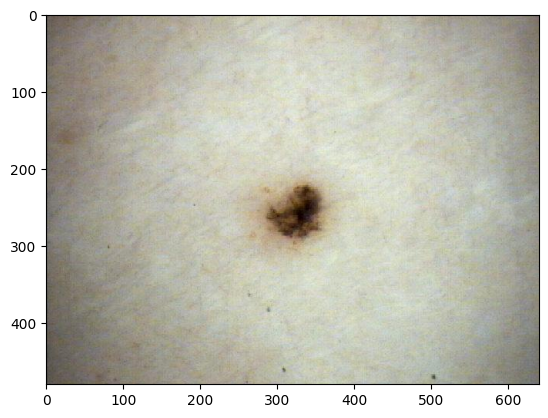

In [6]:
for i, img in enumerate(flist):
    img = Image.open(sdir + img)
    if img.size[0] < 1000:
        plt.imshow(img)
        break

In [23]:
width = pd.Series(width)
height = pd.Series(height)

In [24]:
print('Min and max width: ', min(width), max(width))
print('Min and max height: ', min(height), max(height))

Min and max width:  640 6000
Min and max height:  480 6000


In [25]:
width.describe()

count    33126.000000
mean      4039.630381
std       2109.145590
min        640.000000
25%       1872.000000
50%       5184.000000
75%       6000.000000
max       6000.000000
dtype: float64

In [26]:
height.describe()

count    33126.000000
mean      2678.758256
std       1437.617626
min        480.000000
25%       1053.000000
50%       3456.000000
75%       4000.000000
max       6000.000000
dtype: float64

In [27]:
len(width[width == 6000])

14704

In [28]:
len(height[height == 6000])

4

In [29]:
len(width[(width == 6000) & (height == 6000)])

0

In [30]:
max_dist = -1
for i in range(len(width)):
    max_dist = max(max_dist, abs(width[i] - height[i]))

max_dist

2632

In [31]:
max_resolution = -1
for i in range(len(width)):
    max_resolution = max(max_resolution, width[i] + height[i])

max_resolution

10000

In [32]:
len(height[(height == 4000) & (width == 6000)])

14703

In [33]:
len(height[height - width > 1000])

38

## Research nan samples

In [34]:
nan_cols = labels[labels['anatom_site_general_challenge'].isnull()]
nan_cols

,image_name,patient_id,sex,age_approx,anatom_site_general_challenge,diagnosis,benign_malignant,target
33,ISIC_0086462,IP_3200260,female,30.0,NaN,unknown,benign,0
61,ISIC_0099474,IP_3057277,male,45.0,NaN,unknown,benign,0
188,ISIC_0174903,IP_2760044,male,40.0,NaN,unknown,benign,0
200,ISIC_0178744,IP_4248414,male,25.0,NaN,unknown,benign,0
305,ISIC_0204994,IP_5549010,female,30.0,NaN,nevus,benign,0
...,...,...,...,...,...,...,...,...
32898,ISIC_9928421,IP_0961415,male,45.0,NaN,unknown,benign,0
33001,ISIC_9963692,IP_6017204,female,35.0,NaN,unknown,benign,0
33025,ISIC_9971473,IP_1005683,male,70.0,NaN,unknown,benign,0
33041,ISIC_9975949,IP_9245079,male,40.0,NaN,nevus,benign,0


In [35]:
print('Benign: ', len(nan_cols) - nan_cols.target.sum())
print('Malignant: ', nan_cols.target.sum())

Benign:  518
Malignant:  9


## Plots

Text(0.5, 1.0, 'Width pixels')

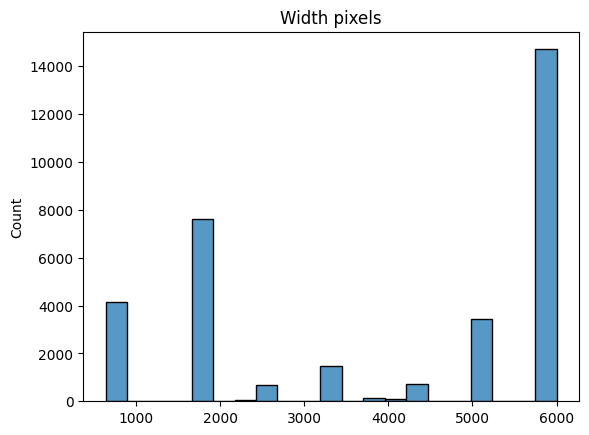

In [36]:
sns.histplot(width)
plt.title('Width pixels')

Text(0.5, 1.0, 'Height pixels')

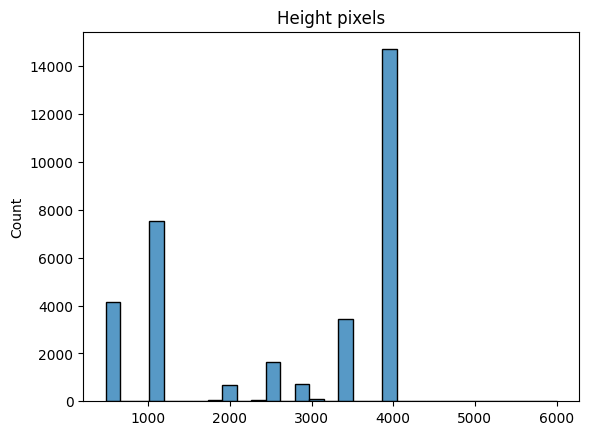

In [37]:
sns.histplot(height)
plt.title('Height pixels')

<Axes: xlabel='target', ylabel='Count'>

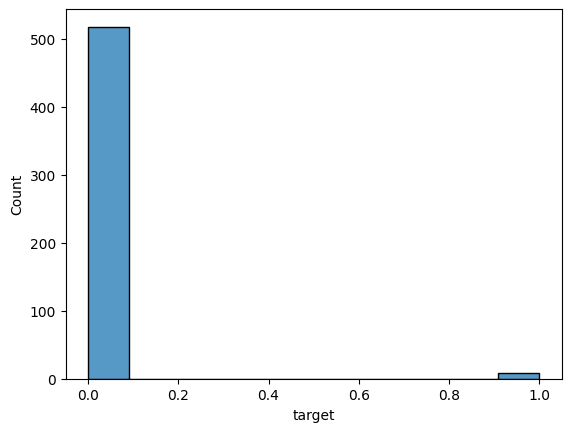

In [38]:
sns.histplot(nan_cols['target'])

<Axes: xlabel='target', ylabel='Count'>

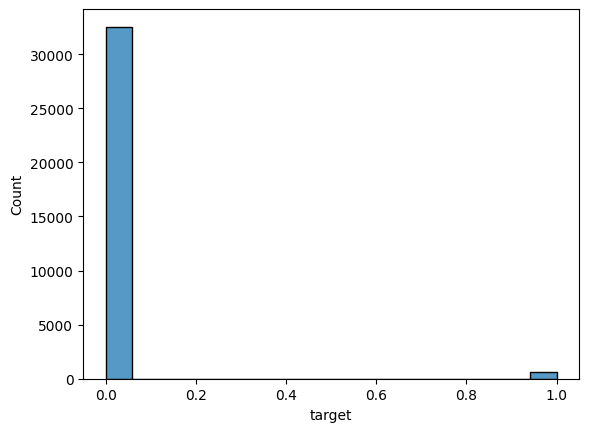

In [39]:
sns.histplot(labels['target'])

<Axes: xlabel='sex', ylabel='Count'>

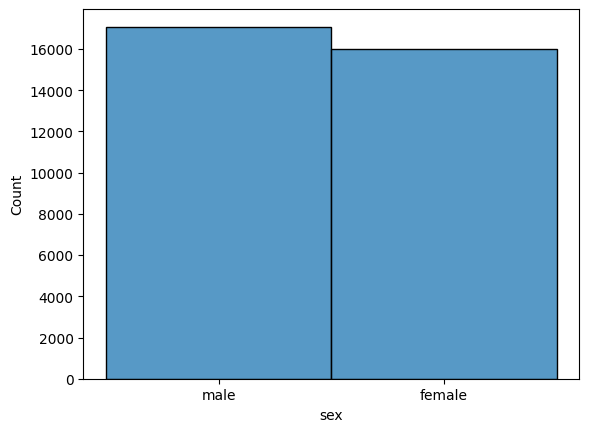

In [40]:
sns.histplot(labels['sex'])

<Axes: xlabel='age_approx', ylabel='Count'>

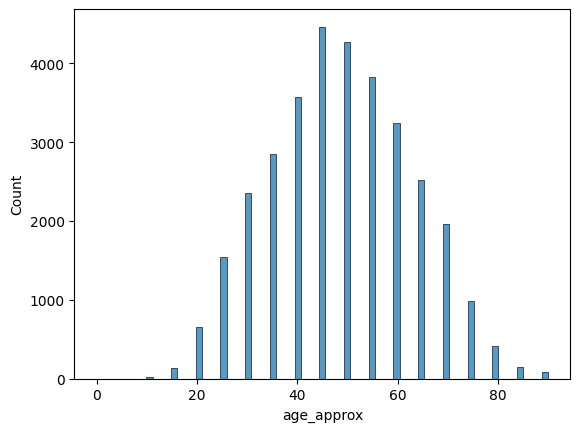

In [41]:
sns.histplot(labels['age_approx'])

<Axes: xlabel='anatom_site_general_challenge', ylabel='Count'>

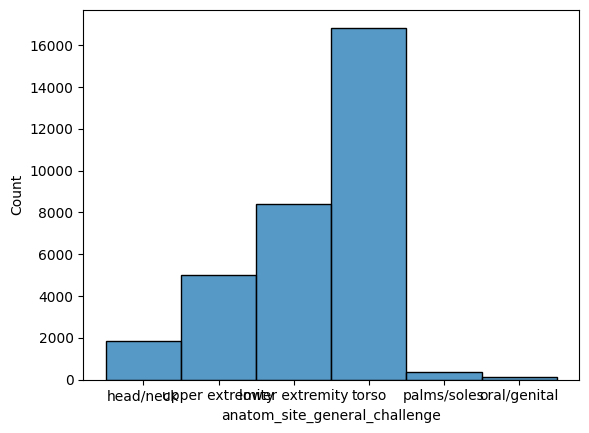

In [42]:
sns.histplot(labels.anatom_site_general_challenge)


# Images

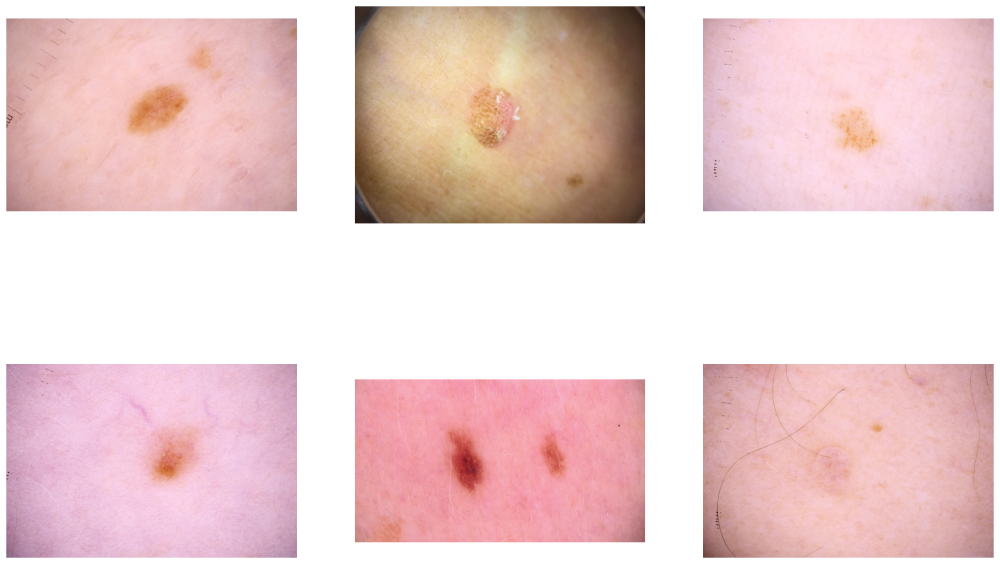

In [43]:
nrows = 4
ncols = 4

plt.figure(figsize=(20,20))

for i in range(6):
    test_img = random.choice(flist)
    test_img = os.path.join(sdir, test_img)
    plt.subplot(331 + i)
    img = cv2.imread(test_img)
    rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(rgb)
    plt.axis('off')

# CleanVision filtering

In [44]:
!pip install cleanvision

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.3/51.3 kB 781.9 kB/s eta 0:00:000:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 4.7 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.6/55.6 kB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 32.2 MB/s eta 0:00:0000:0100:01
DEPRECATION: distro-info 1.1build1 has a non-standard version number. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of distro-info or contact the author to suggest that they release a version with a conforming version number. Discussion can be found at https://github.com/pypa/pip/issues/12063
DEPRECATION: python-debian 0.1.43ubuntu1 has a non-standard version number. pip 24.0 will enforce this behaviour change. A possible replacement is to upgrade to a newer version of python-debian or contact the author to suggest that t

In [13]:
meta_features = ['image_name', 'patient_id', 'sex', 'age_approx', 'anatom_site_general_challenge', 'diagnosis', 'benign_malignant', 'target']

In [14]:
img_names = labels.image_name.values
img_names

array(['ISIC_2637011', 'ISIC_0015719', 'ISIC_0052212', ...,
       'ISIC_9999515', 'ISIC_9999666', 'ISIC_9999806'], dtype=object)

In [18]:
path_dict = {img_name:'../train/' for img_name in img_names}
path_dict

{'ISIC_2637011': '../train/',
 'ISIC_0015719': '../train/',
 'ISIC_0052212': '../train/',
 'ISIC_0068279': '../train/',
 'ISIC_0074268': '../train/',
 'ISIC_0074311': '../train/',
 'ISIC_0074542': '../train/',
 'ISIC_0075663': '../train/',
 'ISIC_0075914': '../train/',
 'ISIC_0076262': '../train/',
 'ISIC_0076545': '../train/',
 'ISIC_0076742': '../train/',
 'ISIC_0076995': '../train/',
 'ISIC_0077472': '../train/',
 'ISIC_0077735': '../train/',
 'ISIC_0078703': '../train/',
 'ISIC_0078712': '../train/',
 'ISIC_0079038': '../train/',
 'ISIC_0080512': '../train/',
 'ISIC_0080752': '../train/',
 'ISIC_0080817': '../train/',
 'ISIC_0081956': '../train/',
 'ISIC_0082348': '../train/',
 'ISIC_0082543': '../train/',
 'ISIC_0082934': '../train/',
 'ISIC_0083035': '../train/',
 'ISIC_0084086': '../train/',
 'ISIC_0084270': '../train/',
 'ISIC_0084395': '../train/',
 'ISIC_0085172': '../train/',
 'ISIC_0085718': '../train/',
 'ISIC_0085902': '../train/',
 'ISIC_0086349': '../train/',
 'ISIC_008

In [19]:
from cleanvision.dataset.base_dataset import Dataset
from cleanvision.dataset.torch_dataset import TorchDataset
import torch

class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, df, path_dict):
        self.path_dict = path_dict
        self.df = df

    def __getitem__(self, index):
        img_name = self.df['image_name'].values[index]
        img_path = self.path_dict[img_name] + img_name + ".jpg"
        img = Image.open(img_path).copy()

        return img, self.df.target[index]

    def __len__(self):
        return self.df.shape[0]

dataset = CustomDataset(labels, path_dict)


In [20]:
dataset[100]

(<PIL.Image.Image image mode=RGB size=640x480>, 0)

In [12]:
from cleanvision import Imagelab


imagelab = Imagelab(torchvision_dataset=dataset)

imagelab.find_issues()

imagelab.report()

Checking for dark, light, odd_aspect_ratio, low_information, exact_duplicates, near_duplicates, blurry, grayscale, odd_size images ...


  0%|          | 0/33126 [00:00<?, ?it/s]

In [ ]:
imagelab.issues.to_csv('ISIC2020_issues.csv')

In [ ]:
duplicates = imagelab.info['exact_duplicates']['sets']
duplicates = pd.DataFrame(duplicates)
duplicates.head(10)

near_duplicates = imagelab.info['near_duplicates']['sets']
near_duplicates = pd.DataFrame(near_duplicates)
near_duplicates.head(10)

duplicates.to_csv('cleanvision_results/duplicates2020.csv')
near_duplicates.to_csv('cleanvision_results/near_duplicates2020.csv')

In [25]:
results = pd.read_csv('../cleanvision_results/ISIC2020_issues.csv')

In [26]:
results

,Unnamed: 0,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
0,0,0.864000,False,0.666667,False,0.819917,False,0.551980,False,1,False,0.818791,False,0.357489,False,1.0,False,1.0,False
1,1,0.864000,False,0.666667,False,0.784896,False,0.474389,False,1,False,0.803293,False,0.533952,False,1.0,False,1.0,False
2,2,0.331702,False,0.562500,False,0.727365,False,0.593989,False,1,False,0.680975,False,0.563444,False,1.0,False,1.0,False
3,3,0.331702,False,0.562500,False,0.855456,False,0.897970,False,1,False,0.543645,False,0.406889,False,1.0,False,1.0,False
4,4,0.864000,False,0.666667,False,0.779153,False,0.403401,False,1,False,0.835542,False,0.547230,False,1.0,False,1.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33121,33121,0.529238,False,0.746914,False,0.824870,False,0.586845,False,1,False,0.993812,False,0.535445,False,1.0,False,1.0,False
33122,33122,0.864000,False,0.666667,False,0.707920,False,0.296280,False,1,False,0.906365,False,0.658336,False,1.0,False,1.0,False
33123,33123,0.331702,False,0.562500,False,0.682727,False,0.567907,False,1,False,0.566782,False,0.522112,False,1.0,False,1.0,False
33124,33124,0.331702,False,0.562500,False,0.683626,False,0.593688,False,1,False,0.526437,False,0.526159,False,1.0,False,1.0,False


In [27]:
check_cols = ['is_odd_size_issue', 'is_odd_aspect_ratio_issue', 'is_low_information_issue', 'is_light_issue', 
              'is_grayscale_issue', 'is_dark_issue', 'is_blurry_issue', 'is_exact_duplicates_issue', 'is_near_duplicates_issue']

In [28]:
for col in check_cols:
    print(col, ': ', results[col].sum())

is_odd_size_issue :  0
is_odd_aspect_ratio_issue :  0
is_low_information_issue :  0
is_light_issue :  0
is_grayscale_issue :  0
is_dark_issue :  7
is_blurry_issue :  1987
is_exact_duplicates_issue :  866
is_near_duplicates_issue :  39


In [29]:
results[results['dark_score'] == 1]

,Unnamed: 0,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
134,134,0.130946,False,0.750000,False,0.592800,False,0.264894,False,1,False,1.0,False,1.000000,False,1.0,False,1.0,False
303,303,0.529238,False,0.746914,False,0.874749,False,0.688675,False,1,False,1.0,False,0.359143,False,1.0,False,1.0,False
391,391,0.476526,False,1.000000,False,0.731506,False,0.355111,False,1,False,1.0,False,0.872078,False,1.0,False,1.0,False
412,412,0.529238,False,0.746914,False,0.851572,False,0.640891,False,1,False,1.0,False,0.375683,False,1.0,False,1.0,False
418,418,0.425967,False,1.000000,False,0.813163,False,0.635927,False,1,False,1.0,False,0.909913,False,1.0,False,1.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32150,32150,0.130946,False,0.750000,False,0.658547,False,0.247547,False,1,False,1.0,False,0.853337,False,1.0,False,1.0,False
32555,32555,0.421242,False,1.000000,False,0.726403,False,0.296400,False,1,False,1.0,False,0.863377,False,1.0,False,1.0,False
32720,32720,0.130946,False,0.750000,False,0.816043,False,0.487891,False,1,False,1.0,False,0.627548,False,1.0,False,1.0,False
32799,32799,0.419352,False,1.000000,False,0.740764,False,0.406967,False,1,False,1.0,False,0.869069,False,1.0,False,1.0,False


In [9]:
condition = results['is_odd_size_issue'] | results['is_odd_aspect_ratio_issue'] | results['is_low_information_issue'] | results['is_light_issue'] | \
 results['is_grayscale_issue'] | results['is_dark_issue'] | results['is_blurry_issue'] | results['is_exact_duplicates_issue'] | results['is_near_duplicates_issue']
results

,Unnamed: 0,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
0,0,0.864000,False,0.666667,False,0.819917,False,0.551980,False,1,False,0.818791,False,0.357489,False,1.0,False,1.0,False
1,1,0.864000,False,0.666667,False,0.784896,False,0.474389,False,1,False,0.803293,False,0.533952,False,1.0,False,1.0,False
2,2,0.331702,False,0.562500,False,0.727365,False,0.593989,False,1,False,0.680975,False,0.563444,False,1.0,False,1.0,False
3,3,0.331702,False,0.562500,False,0.855456,False,0.897970,False,1,False,0.543645,False,0.406889,False,1.0,False,1.0,False
4,4,0.864000,False,0.666667,False,0.779153,False,0.403401,False,1,False,0.835542,False,0.547230,False,1.0,False,1.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33121,33121,0.529238,False,0.746914,False,0.824870,False,0.586845,False,1,False,0.993812,False,0.535445,False,1.0,False,1.0,False
33122,33122,0.864000,False,0.666667,False,0.707920,False,0.296280,False,1,False,0.906365,False,0.658336,False,1.0,False,1.0,False
33123,33123,0.331702,False,0.562500,False,0.682727,False,0.567907,False,1,False,0.566782,False,0.522112,False,1.0,False,1.0,False
33124,33124,0.331702,False,0.562500,False,0.683626,False,0.593688,False,1,False,0.526437,False,0.526159,False,1.0,False,1.0,False


In [10]:
issues = results[condition]
issues

,Unnamed: 0,odd_size_score,is_odd_size_issue,odd_aspect_ratio_score,is_odd_aspect_ratio_issue,low_information_score,is_low_information_issue,light_score,is_light_issue,grayscale_score,is_grayscale_issue,dark_score,is_dark_issue,blurry_score,is_blurry_issue,exact_duplicates_score,is_exact_duplicates_issue,near_duplicates_score,is_near_duplicates_issue
7,7,0.529238,False,0.746914,False,0.823426,False,0.642395,False,1,False,0.740619,False,0.285076,True,1.0,False,1.0,False
16,16,0.667823,False,0.750000,False,0.838601,False,0.654647,False,1,False,0.737091,False,0.261204,True,1.0,False,1.0,False
17,17,0.864000,False,0.666667,False,0.792828,False,0.489800,False,1,False,0.781367,False,0.506734,False,0.5,True,1.0,False
37,37,0.864000,False,0.666667,False,0.751047,False,0.391011,False,1,False,0.830358,False,0.585039,False,0.5,True,1.0,False
38,38,0.864000,False,0.666667,False,0.846600,False,0.717550,False,1,False,0.917077,False,0.369803,False,0.5,True,1.0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33068,33068,0.130946,False,0.750000,False,0.819080,False,0.701135,False,1,False,0.676422,False,0.277186,True,1.0,False,1.0,False
33097,33097,0.331702,False,0.562500,False,0.774170,False,0.802007,False,1,False,0.473916,False,0.255512,True,1.0,False,1.0,False
33102,33102,0.529238,False,0.746914,False,0.841402,False,0.674388,False,1,False,0.742453,False,0.262595,True,1.0,False,1.0,False
33112,33112,0.529238,False,0.746914,False,0.828055,False,0.714263,False,1,False,0.676284,False,0.240777,True,1.0,False,1.0,False


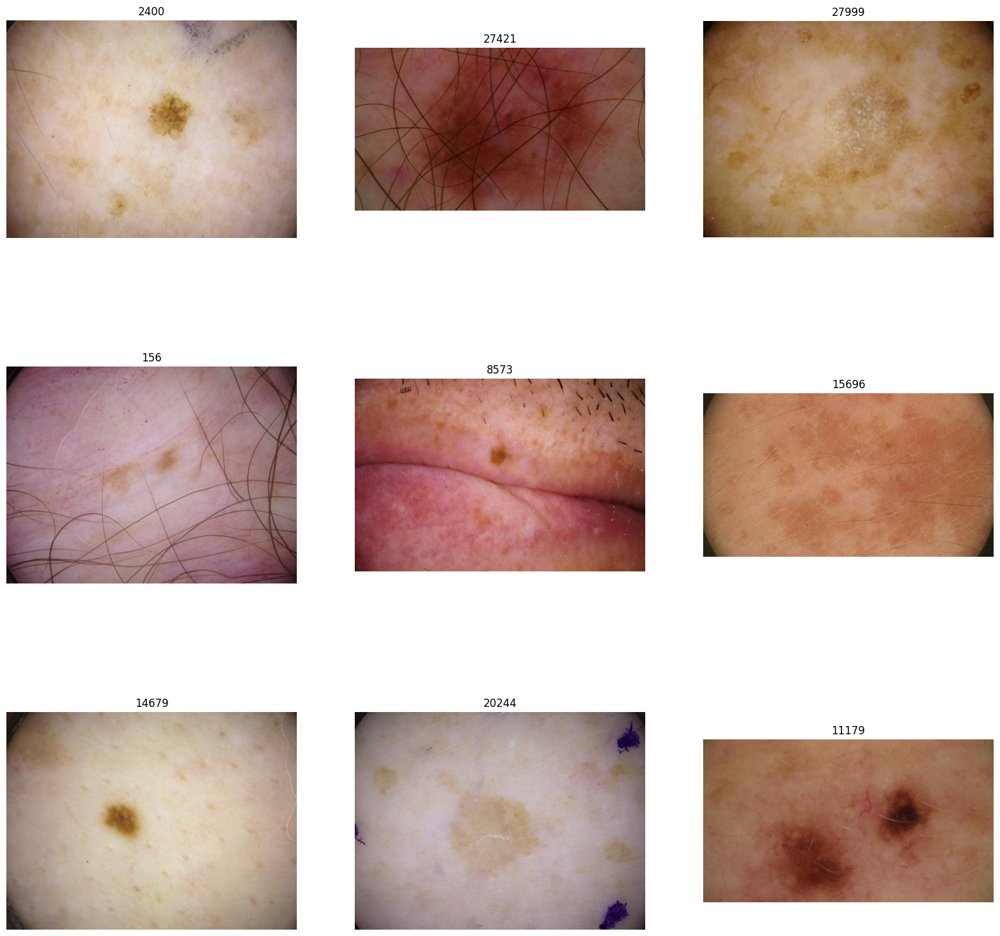

In [33]:
nrows = 5
ncols = 5

plt.figure(figsize=(20,20))

for i in range(9):
    img = random.choice(results[results['is_blurry_issue'] == True].index)
    plt.subplot(331 + i)
    plt.title(img)
    plt.imshow(dataset[img][0])
    plt.axis('off')

In [38]:
duplicates = pd.read_csv('cleanvision_results/duplicates2020.csv')
duplicates = duplicates.rename(columns={"Unnamed: 0": "first", "0": "second", "1": "third"})
duplicates

,first,second,third
0,0,17,28155
1,1,37,15554
2,2,38,13701
3,3,71,19545
4,4,89,24576
...,...,...,...
428,428,29369,31756
429,429,29408,32034
430,430,29722,32287
431,431,30510,32842


In [44]:
duplicates = duplicates[['second', 'third']].rename(columns={'second': 'first', 'third': 'second'})
duplicates

,first,second
0,17,28155
1,37,15554
2,38,13701
3,71,19545
4,89,24576
...,...,...
428,29369,31756
429,29408,32034
430,29722,32287
431,30510,32842


/tmp/ipykernel_62321/2484167401.py:12: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  img2 = int(duplicates[duplicates['first'] == img1]['second'])


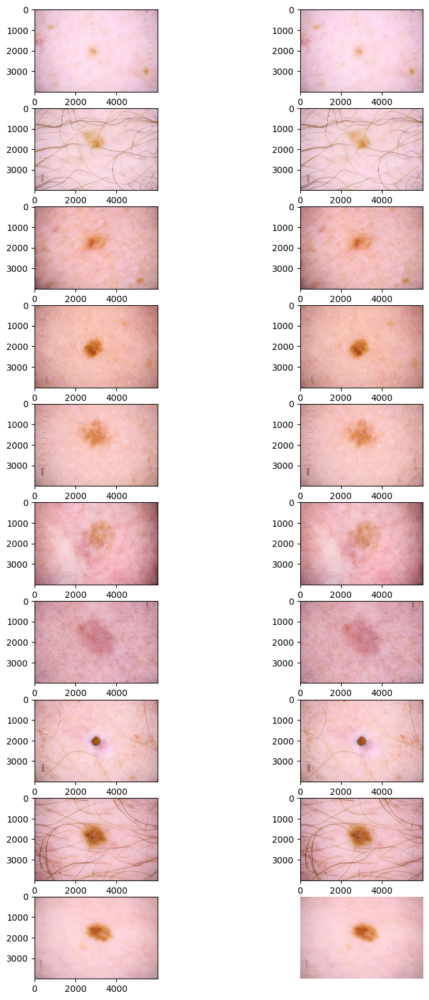

In [51]:
nrows = 4
ncols = 4

f, ax = plt.subplots(10,2)
f.set_figheight(20)
f.set_figwidth(10)

x,y = 0,0

for i in range(10):
    img1 = random.choice(duplicates['first'])
    img2 = int(duplicates[duplicates['first'] == img1]['second'])

    ax[y,x].imshow(dataset[img1][0])
    x += 1
    ax[y,x].imshow(dataset[img2][0])
    y += 1
    x = 0
    plt.axis('off')

In [49]:
near_duplicates = pd.read_csv('cleanvision_results/near_duplicates2020.csv')
near_duplicates = near_duplicates[['0', '1', '2', '3']].rename(columns={'0': 'first', '1': 'second', '2': 'third', '3': 'fourth'})
near_duplicates

,first,second,third,fourth
0,422,6936,NaN,NaN
1,3124,5992,29863.0,NaN
2,4651,26066,NaN,NaN
3,8488,25183,NaN,NaN
4,8564,15277,NaN,NaN
5,8638,24421,NaN,NaN
6,8659,15003,19588.0,21893.0
7,9298,16998,NaN,NaN
8,10334,31810,NaN,NaN
9,12992,30187,NaN,NaN


/tmp/ipykernel_62321/3047986382.py:12: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  img2 = int(near_duplicates[near_duplicates['first'] == img1]['second'])


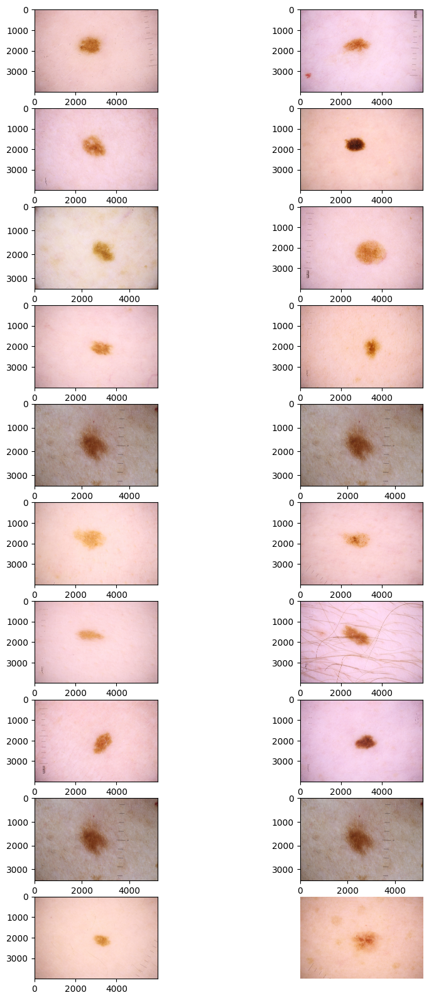

In [50]:
nrows = 4
ncols = 4

f, ax = plt.subplots(10,2)
f.set_figheight(20)
f.set_figwidth(10)

x,y = 0,0

for i in range(10):
    img1 = random.choice(near_duplicates['first'])
    img2 = int(near_duplicates[near_duplicates['first'] == img1]['second'])

    ax[y,x].imshow(dataset[img1][0])
    x += 1
    ax[y,x].imshow(dataset[img2][0])
    y += 1
    x = 0
    plt.axis('off')

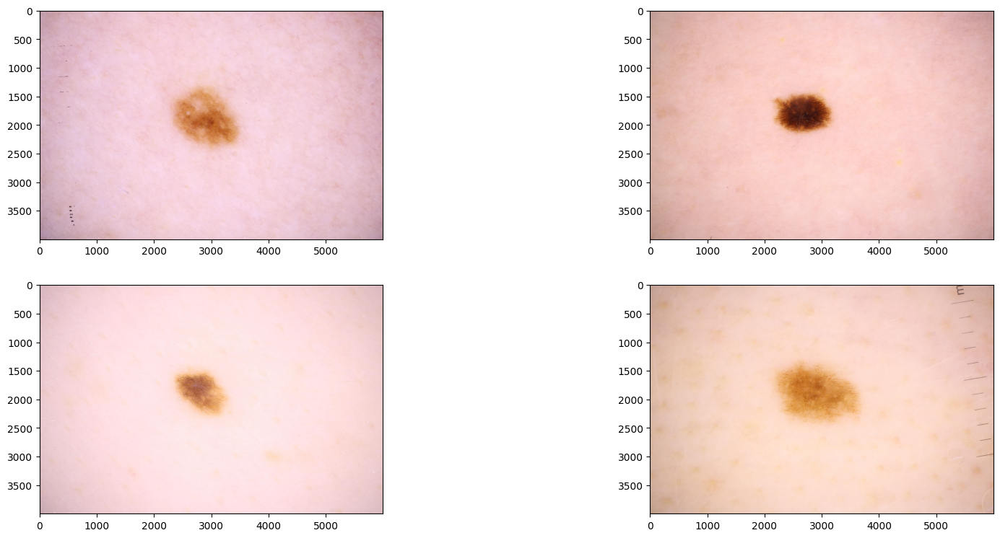

In [54]:
plt.figure(figsize=(20, 14))
plt.subplot(321)
plt.imshow(dataset[8659][0])
plt.subplot(322)
plt.imshow(dataset[15003][0])
plt.subplot(323)
plt.imshow(dataset[19588][0])
plt.subplot(324)
plt.imshow(dataset[21893][0])


In [ ]:
nrows = 4
ncols = 4

f, ax = plt.subplots(10,2)
f.set_figheight(20)
f.set_figwidth(10)

x,y = 0,0

for i in range(10):
    img1 = random.choice(duplicates['first'])
    img2 = int(duplicates[duplicates['first'] == img1]['second'])

    ax[y,x].imshow(dataset[img1][0])
    x += 1
    ax[y,x].imshow(dataset[img2][0])
    y += 1
    x = 0
    plt.axis('off')

In [36]:
sizes = {}
for i, img_path in enumerate(flist):
    img = Image.open(sdir+img_path)
    sizes[img_path[:-4]] = img.size[0], img.size[1]

In [37]:
sizes

{'ISIC_2484586': (640, 480),
 'ISIC_6644441': (1872, 1053),
 'ISIC_2508759': (6000, 4000),
 'ISIC_3342474': (1872, 1053),
 'ISIC_5384663': (6000, 4000),
 'ISIC_5307070': (640, 480),
 'ISIC_6207286': (1872, 1053),
 'ISIC_9862801': (640, 480),
 'ISIC_0811352': (5184, 3456),
 'ISIC_5013602': (6000, 4000),
 'ISIC_4114269': (5184, 3456),
 'ISIC_6319958': (6000, 4000),
 'ISIC_2306653': (1872, 1053),
 'ISIC_3858798': (1872, 1053),
 'ISIC_7487840': (640, 480),
 'ISIC_2019313': (4288, 2848),
 'ISIC_7750443': (1872, 1053),
 'ISIC_0283463': (3888, 2592),
 'ISIC_0797473': (1872, 1053),
 'ISIC_4071342': (5184, 3456),
 'ISIC_2554708': (1872, 1053),
 'ISIC_8139762': (6000, 4000),
 'ISIC_2601107': (2592, 1936),
 'ISIC_1779443': (5184, 3456),
 'ISIC_6023882': (6000, 4000),
 'ISIC_1483604': (6000, 4000),
 'ISIC_9749497': (6000, 4000),
 'ISIC_3018184': (6000, 4000),
 'ISIC_6577388': (3888, 2592),
 'ISIC_4667287': (6000, 4000),
 'ISIC_1151929': (1872, 1053),
 'ISIC_1010525': (6000, 4000),
 'ISIC_9155028':

91
235
314
399
459
475
544
546
551
558
[91, 235, 314, 399, 459, 475, 544, 546, 551, 558]


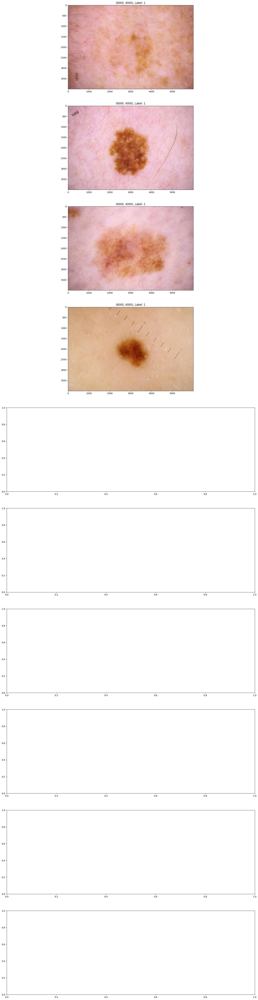

In [50]:
f, ax = plt.subplots(10,1)
f.set_figheight(80)
f.set_figwidth(20)

x = 0

mel_indices = []

for i, data in enumerate(dataset):
    if data[1] == 1:
        print(i)
        mel_indices.append(i)
        if len(mel_indices) == 10:
            break

print(mel_indices)

for i in mel_indices:
    if dataset[i][0].size[0] == 6000 and dataset[i][0].size[1] == 4000:
        ax[x].imshow(dataset[i][0])
        ax[x].title.set_text(f"{dataset[i][0].size}, Label: {dataset[i][1]}")
        x += 1

IndexError: index 10 is out of bounds for axis 0 with size 10

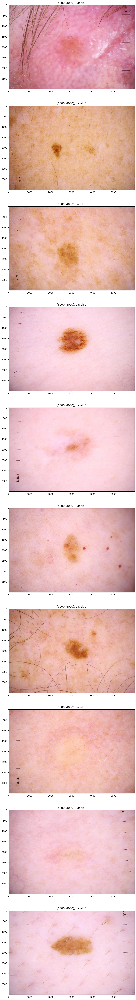

In [53]:
f, ax = plt.subplots(10,1)
f.set_figheight(80)
f.set_figwidth(20)

x = 0

for i in range(len(dataset)):
    if dataset[i][0].size[0] == 6000 and dataset[i][0].size[1] == 4000:
        ax[x].imshow(dataset[i][0])
        ax[x].title.set_text(f"{dataset[i][0].size}, Label: {dataset[i][1]}")
        x += 1